In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns


In [9]:
pd.set_option('display.max_columns', None)
data = pd.read_csv("data_clean.csv")
data

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,10-2014,12.309982,3,1.00,7.073270,8.639411,1.0,0,0,3,7,7.073270,0,1955,1955,98178,47.5112,-122.257,1340,5650
1,12-2014,13.195614,3,2.25,7.851661,8.887653,2.0,0,0,3,7,7.682482,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,02-2015,12.100712,2,1.00,6.646391,9.210340,1.0,0,0,3,6,6.646391,0,1933,1933,98028,47.7379,-122.233,2720,8062
3,12-2014,13.311329,4,3.00,7.580700,8.517193,1.0,0,0,5,7,6.956545,910,1965,1965,98136,47.5208,-122.393,1360,5000
4,02-2015,13.142166,3,2.00,7.426549,8.997147,1.0,0,0,3,8,7.426549,0,1987,1987,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,05-2014,12.793859,3,2.50,7.333023,7.030857,3.0,0,0,3,8,7.333023,0,2009,2009,98103,47.6993,-122.346,1530,1509
21609,02-2015,12.899220,4,2.50,7.745003,8.667852,2.0,0,0,3,8,7.745003,0,2014,2014,98146,47.5107,-122.362,1830,7200
21610,06-2014,12.904459,2,0.75,6.927558,7.207860,2.0,0,0,3,7,6.927558,0,2009,2009,98144,47.5944,-122.299,1020,2007
21611,01-2015,12.899220,3,2.50,7.377759,7.778211,2.0,0,0,3,8,7.377759,0,2004,2004,98027,47.5345,-122.069,1410,1287


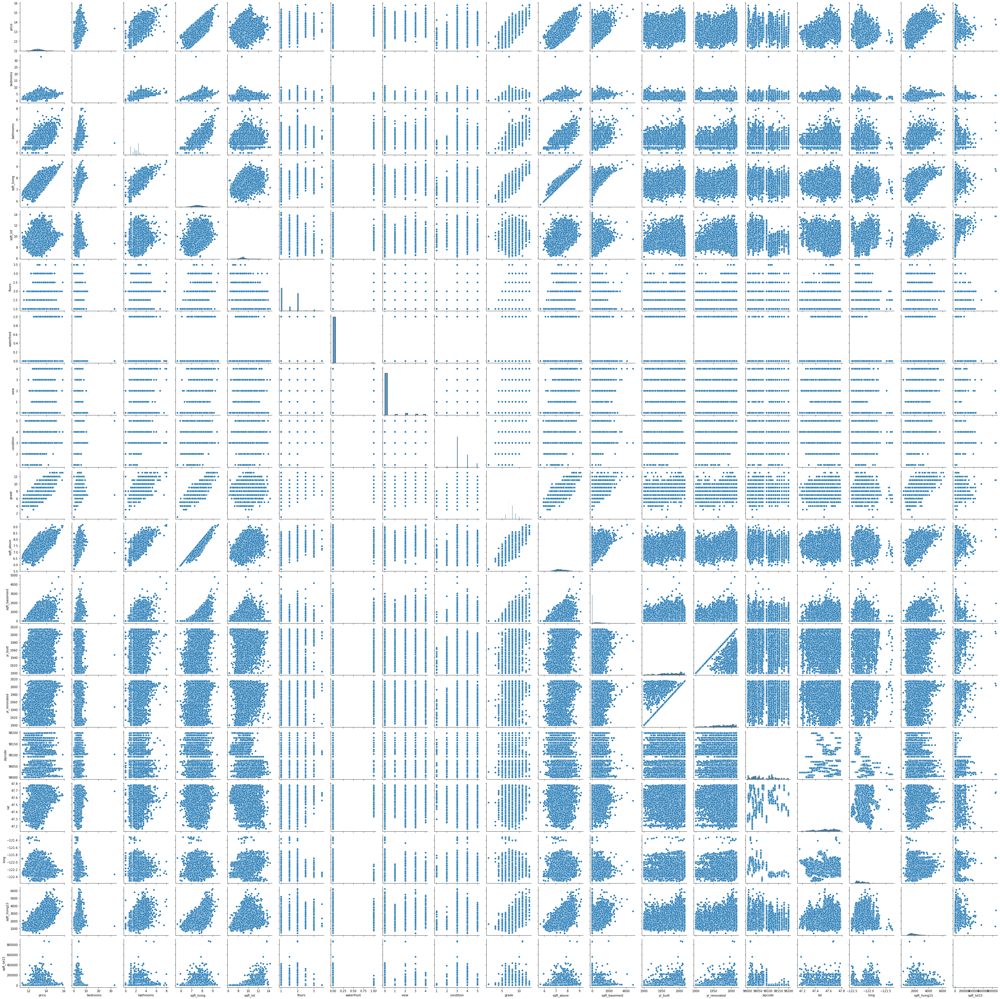

In [10]:
sns.pairplot(data)

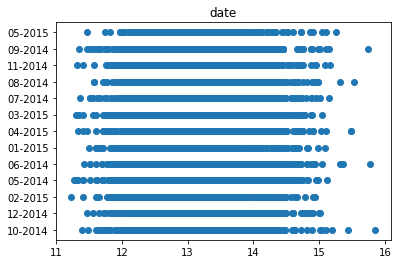

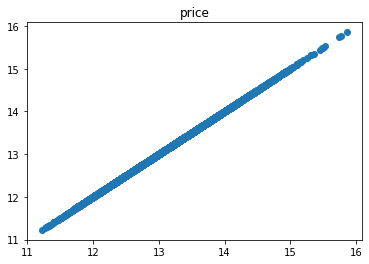

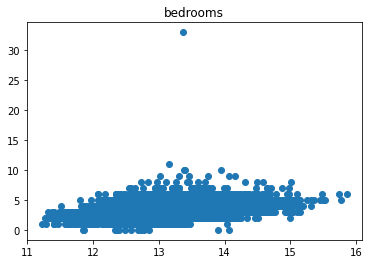

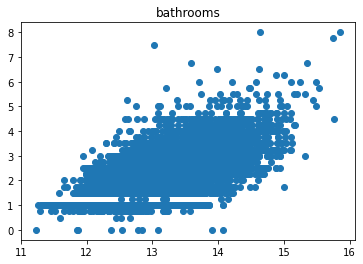

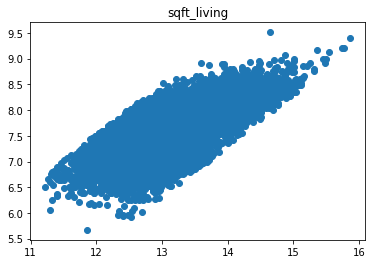

...

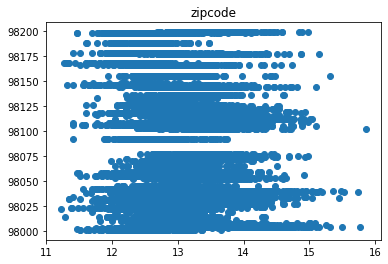

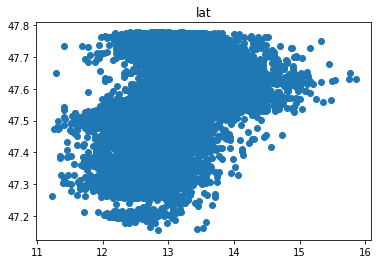

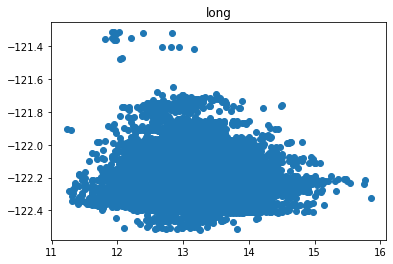

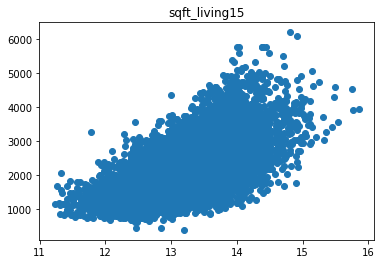

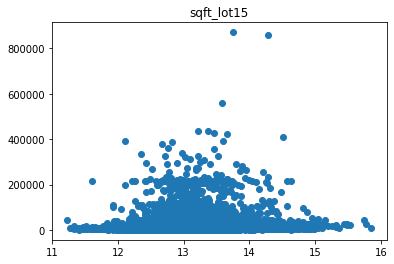

In [4]:
for col in data.columns:
    plt.scatter(x = data['price'], y =data[col])
    plt.title(col)  
    plt.show()

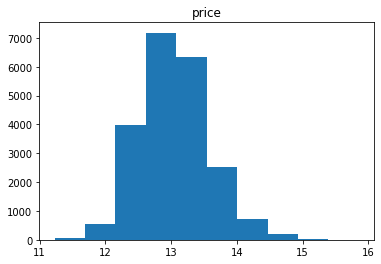

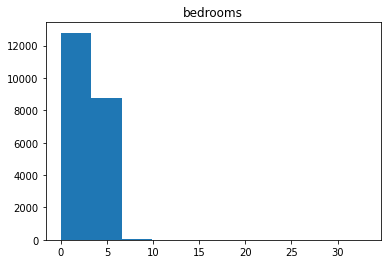

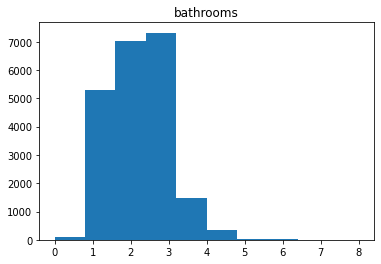

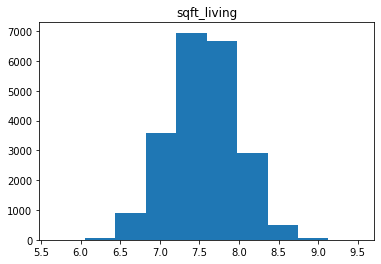

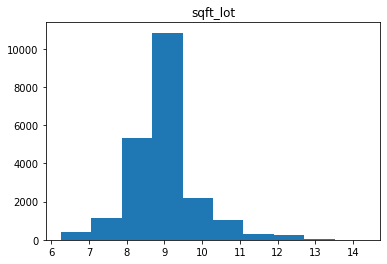

...

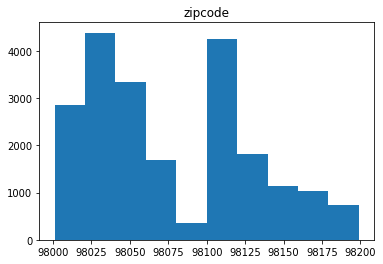

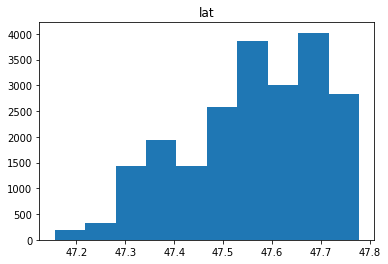

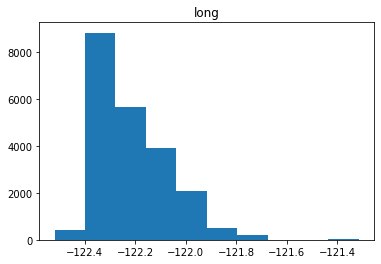

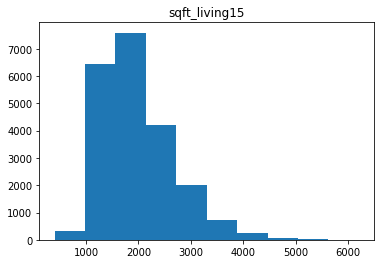

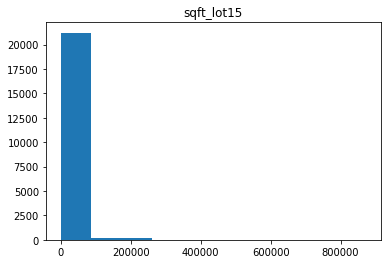

In [20]:
hist = data.copy()
for col in data.columns:
    if (col != 'date'):
        plt.hist(x =hist[col])
        plt.title(col)  
        plt.show()
#histograme repartition des données, distribution normal rechercher

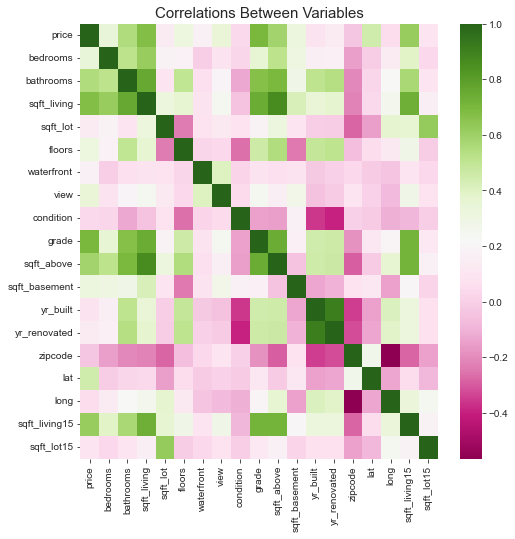

In [ ]:
with sns.axes_style('ticks', {'figure.facecolor': 'white'}):
    plt.figure(figsize=(8,8))
    sns.heatmap(data.corr(),cmap="PiYG")
    plt.title("Correlations Between Variables", size=15)
    plt.show()

In [ ]:
import plotly.express as px 
import plotly.io as pio
pio.renderers.default = "notebook_connected"                                       
fig = px.scatter_mapbox(data, lat='lat', lon='long',color='price')
fig.update_layout(
    mapbox = {
        'style': "stamen-terrain",
        'center': {'lon': -122, 'lat': 47 },
        'zoom': 5},
    showlegend = False,
    height=800)
fig.show()

In [29]:
data.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,10-2014,12.309982,3,1.00,7.073270,8.639411,1.0,0,0,3,7,7.073270,0,1955,1955,98178,47.5112,-122.257,1340,5650
1,12-2014,13.195614,3,2.25,7.851661,8.887653,2.0,0,0,3,7,7.682482,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,02-2015,12.100712,2,1.00,6.646391,9.210340,1.0,0,0,3,6,6.646391,0,1933,1933,98028,47.7379,-122.233,2720,8062
3,12-2014,13.311329,4,3.00,7.580700,8.517193,1.0,0,0,5,7,6.956545,910,1965,1965,98136,47.5208,-122.393,1360,5000
4,02-2015,13.142166,3,2.00,7.426549,8.997147,1.0,0,0,3,8,7.426549,0,1987,1987,98074,47.6168,-122.045,1800,7503


In [28]:
import plotly.express as px 
hist = data.copy()
for col in data.columns:
    if (col != 'date'):
        figure = px.box(hist, x =col, y = 'price')  
        figure.show()

In [1]:
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
import numpy as np
import pandas as pd
from scipy.cluster.hierarchy import dendrogram

def display_circles(pcs, n_comp, pca, axis_ranks, labels=None, label_rotation=0, lims=None):
    for d1, d2 in axis_ranks: # On affiche les 3 premiers plans factoriels, donc les 6 premières composantes
        if d2 < n_comp:

            # initialisation de la figure
            fig, ax = plt.subplots(figsize=(7,6))

            # détermination des limites du graphique
            if lims is not None :
                xmin, xmax, ymin, ymax = lims
            elif pcs.shape[1] < 30 :
                xmin, xmax, ymin, ymax = -1, 1, -1, 1
            else :
                xmin, xmax, ymin, ymax = min(pcs[d1,:]), max(pcs[d1,:]), min(pcs[d2,:]), max(pcs[d2,:])

            # affichage des flèches
            # s'il y a plus de 30 flèches, on n'affiche pas le triangle à leur extrémité
            if pcs.shape[1] < 30 :
                plt.quiver(np.zeros(pcs.shape[1]), np.zeros(pcs.shape[1]),
                   pcs[d1,:], pcs[d2,:], 
                   angles='xy', scale_units='xy', scale=1, color="grey")
                # (voir la doc : https://matplotlib.org/api/_as_gen/matplotlib.pyplot.quiver.html)
            else:
                lines = [[[0,0],[x,y]] for x,y in pcs[[d1,d2]].T]
                ax.add_collection(LineCollection(lines, axes=ax, alpha=.1, color='black'))
            
            # affichage des noms des variables  
            if labels is not None:  
                for i,(x, y) in enumerate(pcs[[d1,d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax :
                        plt.text(x, y, labels[i], fontsize='14', ha='center', va='center', rotation=label_rotation, color="blue", alpha=0.5)
            
            # affichage du cercle
            circle = plt.Circle((0,0), 1, facecolor='none', edgecolor='b')
            plt.gca().add_artist(circle)

            # définition des limites du graphique
            plt.xlim(xmin, xmax)
            plt.ylim(ymin, ymax)
        
            # affichage des lignes horizontales et verticales
            plt.plot([-1, 1], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-1, 1], color='grey', ls='--')

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel('F{} ({}%)'.format(d1+1, round(100*pca.explained_variance_ratio_[d1],1)))
            plt.ylabel('F{} ({}%)'.format(d2+1, round(100*pca.explained_variance_ratio_[d2],1)))

            plt.title("Cercle des corrélations (F{} et F{})".format(d1+1, d2+1))
            plt.show(block=False)
        
def display_factorial_planes(X_projected, n_comp, pca, axis_ranks, labels=None, alpha=1, illustrative_var=None):
    for d1,d2 in axis_ranks:
        if d2 < n_comp:
 
            # initialisation de la figure       
            fig = plt.figure(figsize=(7,6))
        
            # affichage des points
            if illustrative_var is None:
                plt.scatter(X_projected[:, d1], X_projected[:, d2], alpha=alpha)
            else:
                illustrative_var = np.array(illustrative_var)
                for value in np.unique(illustrative_var):
                    selected = np.where(illustrative_var == value)
                    plt.scatter(X_projected[selected, d1], X_projected[selected, d2], alpha=alpha, label=value)
                plt.legend()

            # affichage des labels des points
            if labels is not None:
                for i,(x,y) in enumerate(X_projected[:,[d1,d2]]):
                    plt.text(x, y, labels[i],
                              fontsize='14', ha='center',va='center') 
                
            # détermination des limites du graphique
            boundary = np.max(np.abs(X_projected[:, [d1,d2]])) * 1.1
            plt.xlim([-boundary,boundary])
            plt.ylim([-boundary,boundary])
        
            # affichage des lignes horizontales et verticales
            plt.plot([-100, 100], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-100, 100], color='grey', ls='--')

            # nom des axes, avec le pourcentage d'inertie expliqué
            plt.xlabel('F{} ({}%)'.format(d1+1, round(100*pca.explained_variance_ratio_[d1],1)))
            plt.ylabel('F{} ({}%)'.format(d2+1, round(100*pca.explained_variance_ratio_[d2],1)))

            plt.title("Projection des individus (sur F{} et F{})".format(d1+1, d2+1))
            plt.show(block=False)

def display_scree_plot(pca):
    scree = pca.explained_variance_ratio_*100
    plt.bar(np.arange(len(scree))+1, scree)
    plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
    plt.xlabel("rang de l'axe d'inertie")
    plt.ylabel("pourcentage d'inertie")
    plt.title("Eboulis des valeurs propres")
    plt.show(block=False)

def plot_dendrogram(Z, names):
    plt.figure(figsize=(10,25))
    plt.title('Hierarchical Clustering Dendrogram')
    plt.xlabel('distance')
    dendrogram(
        Z,
        labels = names,
        orientation = "left",
    )
    plt.show()